In [1]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
import scipy.stats as st
import matplotlib.pyplot as plt
import seaborn as sn
from sklearn.metrics import confusion_matrix
import matplotlib.mlab as mlab
# %matplotlib inline



# Python libraries
# import pandas as pd
# import numpy as np
# import seaborn as sns
# import matplotlib.pyplot as plt
# %matplotlib inline
import itertools
from itertools import chain
from sklearn.feature_selection import RFE
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import VotingClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score, learning_curve, train_test_split
from sklearn.metrics import precision_score, recall_score, confusion_matrix, roc_curve, precision_recall_curve, accuracy_score
import warnings
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff

warnings.filterwarnings('ignore') #ignore warning messages 

In [2]:
data = pd.read_csv("C:/Users/gold/Desktop/models/datas/data.csv")

X = pd.read_csv("C:/Users/gold/Desktop/models/experiment1/PCAtransform2.csv")

y = data['level']

In [3]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
y = encoder.fit_transform(y)
print(y)

train_X, test_X, train_y, test_y = train_test_split(X, y, test_size = 0.2, random_state = 101)
print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

[0 0 0 ... 3 3 3]
(2584, 6) (2584,) (647, 6) (647,)


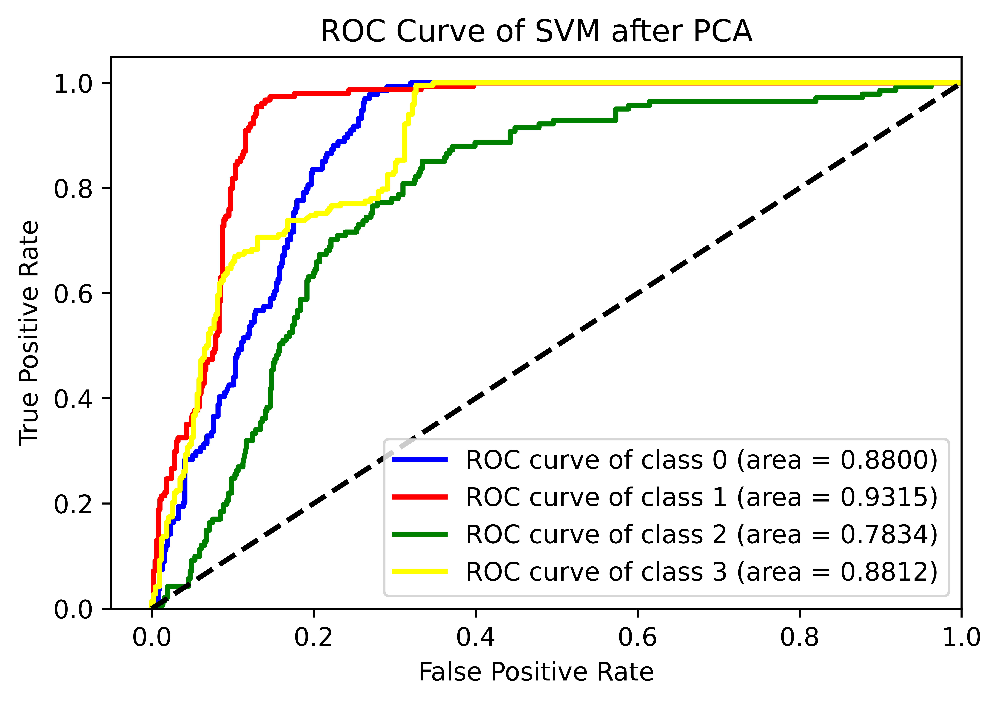

In [4]:
from sklearn import svm
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.svm import SVC
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(svm.SVC(kernel = 'linear', probability=True, random_state = 0))

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 1500)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of SVM after PCA')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of SVM after PCA.png", dpi = 1500)
plt.legend(loc="lower right")
plt.show()


In [5]:
svm = SVC(kernel = 'linear', degree = 2, random_state = 0)
svm.fit(train_X, train_y)
prediction = svm.predict(test_X)
print('The accuracy of the linear SVM is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_lsvm = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of the linear SVM is:')
print(recall_lsvm)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of the linear SVM is:')
print(f1)

The accuracy of the linear SVM is: 0.6769706336939721
The Recall of the linear SVM is:
[0.77868852 0.74233129 0.57608696 0.62592593]
The f1 score of the linear SVM is:
0.6624332653691578


In [6]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn import svm

svm = svm.SVC(kernel = 'linear', probability=True, random_state = 0)
# logreg=LogisticRegression()
svm.fit(train_X,train_y)

# Make predictions.
log_pred = svm.predict(test_X)

#CV score
svm_cv = cross_val_score(svm, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % svm.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % svm_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.6986
Cross-validation accuracy: 0.6625
Recall:
[0.67153285 0.83783784 0.63636364 0.66346154]
F1 score: 0.7012
Confusion Matrix:
[[ 92  45   0   0]
 [ 24 124   0   0]
 [  0   0  98  56]
 [  0   0  70 138]]


In [7]:
from sklearn import svm
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.svm import SVC
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
from scipy import interp

y = label_binarize(y, classes=[0, 1, 2, 3])
# y = label_binarize(y, classes=[1, 2, 3, 4])
n_classes = y.shape[1]
# n_classes = len(np.unique(y))

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state = 2)

classifier = OneVsRestClassifier(svm.SVC(kernel = 'rbf', probability = True, random_state = 0))
y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of kernel SVM after PCA')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of kernel SVM after PCA.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()

In [8]:
ksvm = SVC(kernel = 'rbf', degree = 2, random_state = 0)
ksvm.fit(train_X, train_y)
prediction = ksvm.predict(test_X)
print('The accuracy of the kernel SVM is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_ksvm = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of the kernel SVM is:')
print(recall_ksvm)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of the kernel SVM is:')
print(f1)

The accuracy of the kernel SVM is: 0.7557959814528593
The Recall of the kernel SVM is:
[0.79069767 0.77564103 0.66292135 0.80434783]
The f1 socre of the kernel SVM is:
0.7572288347805831


In [9]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn import svm

ksvm = svm.SVC(kernel = 'rbf', probability=True, random_state = 0)
# logreg=LogisticRegression()
ksvm.fit(train_X,train_y)

# Make predictions.
log_pred = ksvm.predict(test_X)

#CV score
ksvm_cv = cross_val_score(ksvm, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % ksvm.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % ksvm_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.7558
Cross-validation accuracy: 0.7221
Recall:
[0.74452555 0.81756757 0.76623377 0.71153846]
F1 score: 0.7572
Confusion Matrix:
[[102  35   0   0]
 [ 27 121   0   0]
 [  0   0 118  36]
 [  0   0  60 148]]


In [10]:
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
from scipy import interp
from sklearn.preprocessing import LabelBinarizer

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=0)

classifier = LogisticRegression() 
ovr = OneVsRestClassifier(classifier)
y_score = ovr.fit(X_train, y_train).predict_proba(X_test)

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

# plt.plot(fpr, tpr, linewidth=2)
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of Logistic Regression after PCA')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of Logistic Regression after PCA.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()

In [11]:
# Logistic Regression
lr = LogisticRegression()
lr.fit(train_X, train_y)
prediction = lr.predict(test_X)
print('The accuracy of the Logistic Regression is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_lr = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of Logistic Regression is:')
print(recall_lr)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of Logistic Regression is:')
print(f1)

The accuracy of the Logistic Regression is: 0.7017001545595054
The Recall of Logistic Regression is:
[0.7704918  0.73619632 0.61594203 0.69196429]
The f1 score of Logistic Regression is:
0.6993393198368862


In [12]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn.linear_model import LogisticRegression

logreg=LogisticRegression()
logreg.fit(train_X,train_y)

# Make predictions.
log_pred=logreg.predict(test_X)

#CV score
logreg_cv = cross_val_score(logreg, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % logreg.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % logreg_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.7017
Cross-validation accuracy: 0.6575
Recall:
[0.68613139 0.81081081 0.55194805 0.74519231]
F1 score: 0.6993
Confusion Matrix:
[[ 94  43   0   0]
 [ 28 120   0   0]
 [  0   0  85  69]
 [  0   0  53 155]]


In [13]:
from sklearn import metrics 
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(RandomForestClassifier(n_estimators=10))

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of Random Forest after PCA')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of Random Forest after PCA.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()


In [14]:
# RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(train_X, train_y)
prediction = rf.predict(test_X)
print('The accuracy of the rf is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_rf = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of Random Forest Classifier is:')
print(recall_rf)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of Random Forest Classifier is:')
print(f1)

The accuracy of the rf is: 0.9350850077279753
The Recall of Random Forest Classifier is:
[0.94827586 0.84023669 0.97385621 0.97607656]
The f1 score of Random Forest Classifier is:
0.9286413940735158


In [15]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

rf = RandomForestClassifier()
rf.fit(train_X,train_y)

# Make predictions.
log_pred = rf.predict(test_X)

#CV score
rf_cv = cross_val_score(rf, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % rf.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % rf_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.9304
Cross-validation accuracy: 0.9304
Recall:
[0.81021898 0.93243243 0.97402597 0.97596154]
F1 score: 0.9236
Confusion Matrix:
[[111  26   0   0]
 [ 10 138   0   0]
 [  0   0 150   4]
 [  0   0   5 203]]


In [16]:
from sklearn import metrics 
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(DecisionTreeClassifier())

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of Decision Tree after PCA')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of Decision Tree after PCA.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()

In [17]:
# Decision Tree
dt = DecisionTreeClassifier()
dt.fit(train_X, train_y)
prediction = dt.predict(test_X)
print('The accuracy of the Decision Tree is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_dt = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of Decision Tree Classifier is:')
print(recall_dt)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of Decision Tree Classifier is:')
print(f1)

The accuracy of the Decision Tree is: 0.8794435857805255
The Recall of Decision Tree Classifier is:
[0.75757576 0.75816993 0.96178344 0.98536585]
The f1 score of Decision Tree Classifier is:
0.8658819672715649


In [18]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

dt = DecisionTreeClassifier()
dt.fit(train_X,train_y)

# Make predictions.
log_pred = dt.predict(test_X)

#CV score
dt_cv = cross_val_score(dt, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % dt.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % dt_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.8841
Cross-validation accuracy: 0.8920
Recall:
[0.72992701 0.81081081 0.98051948 0.96634615]
F1 score: 0.8713
Confusion Matrix:
[[100  37   0   0]
 [ 28 120   0   0]
 [  0   0 151   3]
 [  0   0   7 201]]


In [19]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(KNeighborsClassifier(n_neighbors=3))

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of KNeighbors Classifier after PCA')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of KNeighbors Classifier after PCA.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()


In [20]:
# K-Nearest Neighbours
knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(train_X, train_y)
prediction = knn.predict(test_X)
print('The accuracy of the KNN is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_knn = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of K-Neighbors Classifier is:')
print(recall_knn)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of K-Neighbors Classifier is:')
print(f1)

The accuracy of the KNN is: 0.8052550231839258
The Recall of K-Neighbors Classifier is:
[0.77372263 0.79054054 0.8        0.83962264]
The f1 score of K-Neighbors Classifier is:
0.8003389750268353


In [21]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(train_X,train_y)

# Make predictions.
log_pred = knn.predict(test_X)

#CV score
knn_cv = cross_val_score(knn, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % knn.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % knn_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.8053
Cross-validation accuracy: 0.8150
Recall:
[0.77372263 0.79054054 0.77922078 0.85576923]
F1 score: 0.8003
Confusion Matrix:
[[106  31   0   0]
 [ 31 117   0   0]
 [  0   0 120  34]
 [  0   0  30 178]]


In [22]:
from xgboost.sklearn import XGBClassifier
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(XGBClassifier())

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of XGBClassifier after PCA')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of XGBClassifier after PCA.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()


In [23]:
# XGBClassifier
xgb = XGBClassifier()
xgb.fit(train_X, train_y)
prediction = xgb.predict(test_X)
print('The accuracy of the XGB is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_xgb = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of XGB Classifier is:')
print(recall_xgb)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of XGB Classifier is:')
print(f1)

The accuracy of the XGB is: 0.9613601236476044
The Recall of XGB Classifier is:
[0.96850394 0.91139241 0.97419355 0.98550725]
The f1 score of XGB Classifier is:
0.9583683652110129


In [24]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from xgboost.sklearn import XGBClassifier

xgb = XGBClassifier()
xgb.fit(train_X,train_y)

# Make predictions.
log_pred = xgb.predict(test_X)

#CV score
xgb_cv = cross_val_score(xgb, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % xgb.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % xgb_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.9614
Cross-validation accuracy: 0.9435
Recall:
[0.89781022 0.97297297 0.98051948 0.98076923]
F1 score: 0.9584
Confusion Matrix:
[[123  14   0   0]
 [  4 144   0   0]
 [  0   0 151   3]
 [  0   0   4 204]]


In [25]:
from sklearn.linear_model import SGDClassifier
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(estimator=SGDClassifier())

y_score = classifier.fit(X_train, y_train).predict(X_test)

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of SGDClassifier after PCA')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of SGDClassifier after PCA.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()


In [26]:
from sklearn.linear_model import SGDClassifier
sgd = SGDClassifier()
sgd.fit(train_X, train_y)
prediction = sgd.predict(test_X)
print('The accuracy of the SGDClassifier is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_sgd = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of SGD Classifier is:')
print(recall_sgd)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of SGD Classifier is:')
print(f1)

The accuracy of the SGDClassifier is: 0.642967542503864
The Recall of SGD Classifier is:
[0.75       0.68648649 0.52020202 0.67682927]
The f1 socre of SGD Classifier is:
0.6444189053608715


In [27]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn.linear_model import SGDClassifier

sgd = SGDClassifier()
sgd.fit(train_X,train_y)

# Make predictions.
log_pred = sgd.predict(test_X)

#CV score
sgd_cv = cross_val_score(sgd, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % sgd.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % sgd_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.6430
Cross-validation accuracy: 0.6296
Recall:
[0.59124088 0.86486486 0.62987013 0.52884615]
F1 score: 0.6468
Confusion Matrix:
[[ 81  56   0   0]
 [ 20 128   0   0]
 [  1   1  97  55]
 [  0   8  90 110]]


In [28]:
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics 
from sklearn.metrics import f1_score, accuracy_score, recall_score, log_loss, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc

y = label_binarize(y, classes=[0, 1, 2, 3])
n_classes = y.shape[1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

classifier = OneVsRestClassifier(GaussianNB())

y_score = classifier.fit(X_train, y_train).predict_proba(X_test)

plt.figure(dpi = 3000)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
    colors = cycle(['blue', 'red', 'green','yellow'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.4f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([-0.05, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve of GaussianNB after PCA')
plt.savefig("C:\\Users\\gold\\Desktop\\models\\newexperiment\\ROC Curve of GaussianNB after PCA.png", dpi = 3000)
plt.legend(loc="lower right")
plt.show()

In [29]:
from sklearn.naive_bayes import GaussianNB
gaussian = GaussianNB() 
gaussian.fit(train_X, train_y) 
prediction = gaussian.predict(test_X) 
acc_gaussian = round(gaussian.score(train_X, train_y) * 100, 2) 
print(acc_gaussian)
print('The Accuracy of the gaussianNB is: {0}'.format(metrics.accuracy_score(prediction,test_y)))
recall_gaussian = recall_score(prediction,test_y, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('The Recall of GaussianNB is:')
print(recall_gaussian)
f1 = f1_score(prediction,test_y,average='macro', labels=None)
print('The f1 score of GaussianNB is:')
print(f1)

66.76
The accuracy of the gaussiand is: 0.6738794435857806
The Recall of GaussianNB is:
[0.69642857 0.67403315 0.61151079 0.70232558]
The f1 socre of GaussianNB is:
0.665575032545784


In [30]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler_X = StandardScaler()
train_X = scaler_X.fit_transform(train_X)
test_X = scaler_X.transform(test_X)

from sklearn.naive_bayes import GaussianNB

gaussian = GaussianNB()
gaussian.fit(train_X,train_y)

# Make predictions.
log_pred = gaussian.predict(test_X)

#CV score
gaussian_cv = cross_val_score(gaussian, train_X, train_y, cv=10).mean()
print('Accuracy: %.4f' % gaussian.score(test_X, test_y))

# Cross-Validation accuracy
print('Cross-validation accuracy: %0.4f' % gaussian_cv)

# Precision
# print('Precision: %.4f' % precision_score(test_y, log_pred))

# Recall
recall_lr = recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn')
print('Recall:')
print(recall_lr)
# print('Recall: %.4f' % recall_score(test_y, log_pred, labels=None, pos_label=1, average=None, sample_weight=None, zero_division='warn'))

# f1 score: best value at 1 (perfect precision and recall) and worst at 0.
print('F1 score: %.4f' % f1_score(test_y, log_pred, average='macro', labels=None))

print('Confusion Matrix:')
print(confusion_matrix(test_y, log_pred))

Accuracy: 0.6739
Cross-validation accuracy: 0.6641
Recall:
[0.56934307 0.82432432 0.55194805 0.72596154]
F1 score: 0.6656
Confusion Matrix:
[[ 78  59   0   0]
 [ 26 122   0   0]
 [  5   0  85  64]
 [  3   0  54 151]]
